C:\Users\Alex\AppData\Local\Temp\ipykernel_21144\2171033893.py:71: DtypeWarning: Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(INPUT_CSV)


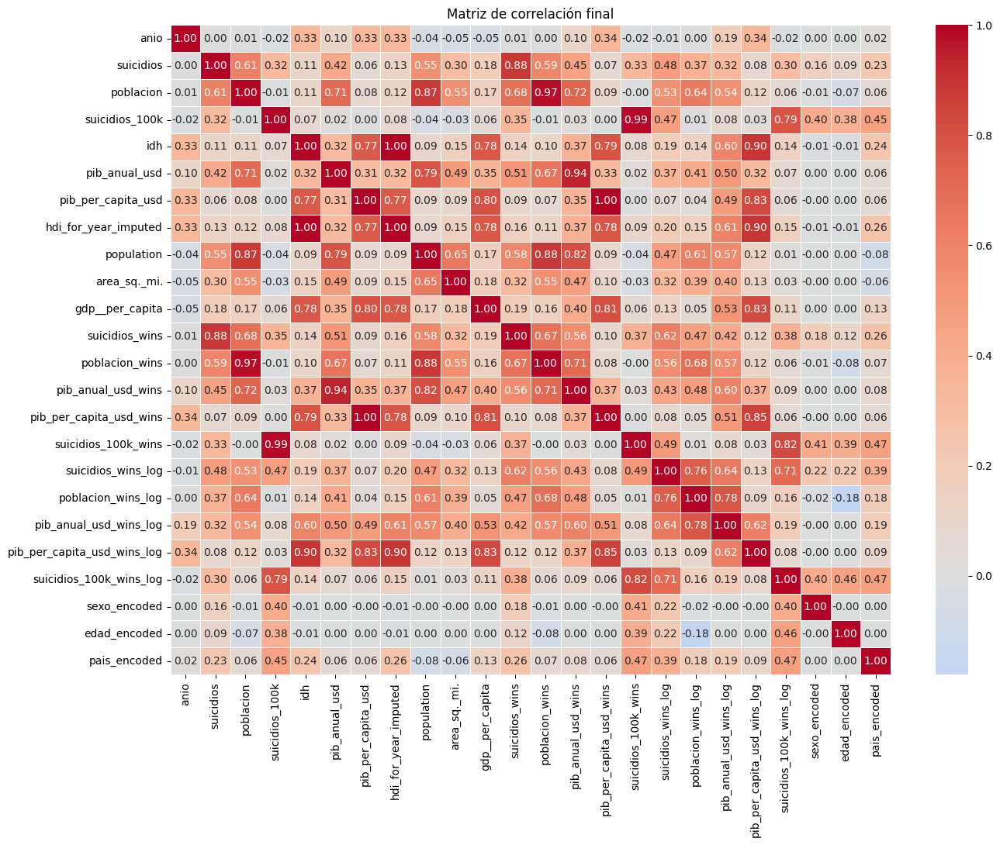

C:\Users\Alex\AppData\Local\Temp\ipykernel_21144\2171033893.py:248: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




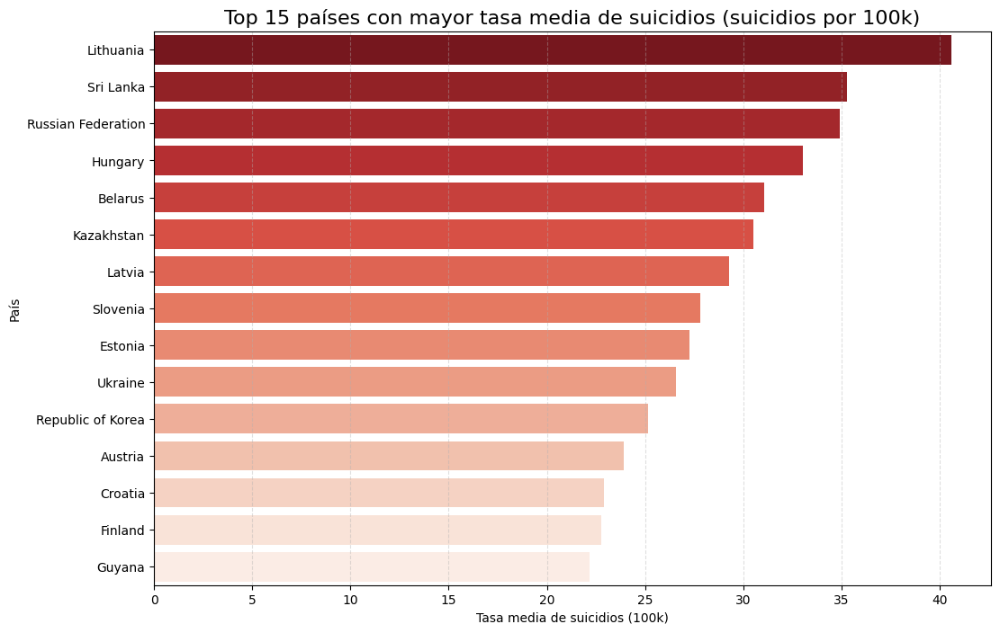

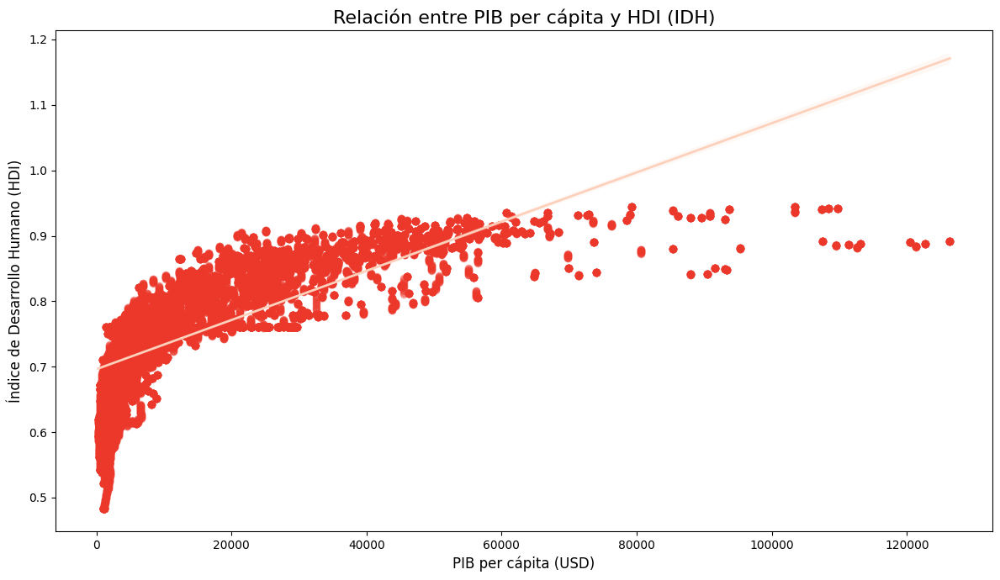

<Figure size 1800x800 with 0 Axes>

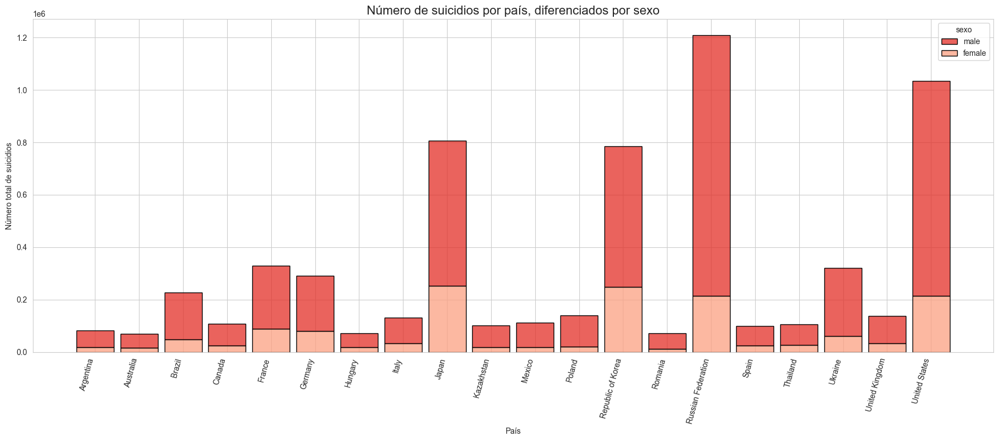

In [1]:

'''Country :  Nombre oficial del país correspondiente al registro.
Year: Año al que pertenece la observación (formato numérico).
Sex:  Sexo del grupo poblacional:
•	male
•	female
age: Grupo de edad definido por la OMS:
•	5-14 years
•	15-24 years
•	25-34 years
•	35-54 years
•	55-74 years
•	75+ years
suicides_no: Número total de suicidios registrados en ese país, año, sexo y grupo de edad.
Population: Población estimada para ese país, año, sexo y grupo de edad.
suicides/100k pop: Tasa de suicidios por cada 100.000 habitantes en ese grupo poblacional.
Generation:  Categoría generacional deducida a partir del grupo de edad del registro.
Ej.: Boomers, Generation X, Silent Generation, etc.
HDI for year:  Índice de Desarrollo Humano reportado para ese país en ese año.
Puede incluir valores faltantes.
HDI_for_year_imputed: Versión del IDH con valores imputados mediante interpolación para completar series temporales.
gdp_for_year ($): PIB total anual del país, expresado en dólares internacionales.
gdp_per_capita ($): PIB per cápita del país, expresado en dólares internacionales.
Region: Región geográfica a la que pertenece el país.
Area (sq. mi.): Superficie total del país, medida en millas cuadradas.
Population: Población total estimada del país (no desagregada por edad/sexo).
Pop. Density (per sq. mi.): Densidad poblacional: habitantes por milla cuadrada.
Coastline (coast/area ratio): Relación entre longitud de costa y superficie total del país.
Net migration: Tasa neta de migración (inmigrantes menos emigrantes por cada 1.000 habitantes).
Infant mortality (per 1000 births): Tasa de mortalidad infantil por cada 1.000 nacidos vivos.v
GDP ($ per capita): PIB per cápita incluido en el dataset de países (puede diferir de la versión OMS).
Literacy (%): Tasa de alfabetización de la población adulta expresada en porcentaje.
Phones (per 1000): Cantidad de líneas telefónicas por cada 1.000 habitantes.
Arable (%) : Porcentaje de superficie del país apta para agricultura.
Crops (%): Porcentaje de superficie destinada específicamente a cultivos.
Other (%): Porcentaje restante del territorio no clasificado como agrícola ni cultivado.
Climate: Clasificación climática del país según una escala numérica.
Birthrate: Tasa de natalidad por cada 1.000 habitantes.
Deathrate: Tasa de mortalidad general por cada 1.000 habitantes.
Agriculture: Porcentaje del PIB procedente del sector agrícola.
Industry: Porcentaje del PIB procedente del sector industrial.
Service: Porcentaje del PIB procedente del sector servicios.
'''


# ===================================================================
# Pipeline final listo para entrega
# Entrada esperada: data/master_final_from_original.csv
# ===================================================================


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import requests
import os

# ---------------------------
# Config
# ---------------------------
INPUT_CSV = "data/master_final.csv"
OUTPUT_CSV = "data/master_final.csv"  
CORR_CSV = "data/final_correlation_matrix.csv"
MAP_HTML = "data/mapa_animado.html"
RACE_HTML = "data/race_chart.html"

# ---------------------------
# 0) Carga
# ---------------------------
df = pd.read_csv(INPUT_CSV)
df.columns = df.columns.str.strip()  # eliminar espacios en headers

# ---------------------------
# 1) Limpieza inicial y renombrado claro
# ---------------------------
df = df.drop(columns=["country-year"], errors="ignore")

df = df.rename(columns={
    "country": "pais",
    "year": "anio",
    "sex": "sexo",
    "age": "edad",
    "suicides_no": "suicidios",
    "population": "poblacion",
    "suicides/100k pop": "suicidios_100k",
    "HDI for year": "idh",
    "gdp_for_year ($)": "pib_anual_usd",
    " gdp_for_year ($) ": "pib_anual_usd",
    "gdp_per_capita ($)": "pib_per_capita_usd",
    "generation": "generacion"
})

# Filtrado temporal por años válidos
df["anio"] = pd.to_numeric(df["anio"], errors="coerce")
df = df[(df["anio"] >= 1985) & (df["anio"] <= 2015)]

# Limpieza de cadenas numéricas (PIB)
if "pib_anual_usd" in df.columns:
    df["pib_anual_usd"] = df["pib_anual_usd"].astype(str).str.replace(",", "", regex=False)
    df["pib_anual_usd"] = pd.to_numeric(df["pib_anual_usd"], errors="coerce")

# Normalizar nombres (snake_case)
df.columns = (
    df.columns.str.lower()
    .str.replace(" ", "_")
    .str.replace(r"[()$]", "", regex=True)
    .str.replace("/", "_")
)

# ---------------------------
# 2) Tipificación numérica
# ---------------------------
numeric_cols = ["anio", "suicidios", "poblacion", "suicidios_100k", "idh", "pib_anual_usd", "pib_per_capita_usd"]
for c in numeric_cols:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors="coerce")

# ---------------------------
# 3) Imputación avanzada por país (interpolación)
# ---------------------------
df = df.sort_values(["pais", "anio"])
to_interp = [c for c in ["idh", "pib_anual_usd", "pib_per_capita_usd"] if c in df.columns]
if to_interp:
    df[to_interp] = df.groupby("pais")[to_interp].transform(lambda x: x.interpolate(method="linear"))
    df[to_interp] = df.groupby("pais")[to_interp].transform(lambda x: x.ffill().bfill())

# ---------------------------
# 4) Winsorización (1% - 99%)
# ---------------------------
def winsorize(series, lower=0.01, upper=0.99):
    ql = series.quantile(lower)
    qh = series.quantile(upper)
    return series.clip(lower=ql, upper=qh)

winsorize_targets = [c for c in ["suicidios", "poblacion", "pib_anual_usd", "pib_per_capita_usd", "suicidios_100k"] if c in df.columns]
for c in winsorize_targets:
    df[c + "_wins"] = winsorize(df[c])

# ---------------------------
# 5) Fallback fill (median) para numeric remanente
# ---------------------------
for c in numeric_cols:
    if c in df.columns and df[c].isnull().any():
        df[c] = df[c].fillna(df[c].median())

# ---------------------------
# 6) Transformaciones log (log1p) sobre cols wins
# ---------------------------
for base in [c for c in df.columns if c.endswith("_wins")]:
    df[base + "_log"] = np.log1p(df[base])

# ---------------------------
# 7) Encoding categórico
# ---------------------------
# sexo
if "sexo" in df.columns:
    df["sexo_encoded"] = df["sexo"].map({"male": 1, "female": 0})

# edad (ordinal mapping)
age_map = {"5-14 years": 1, "15-24 years": 2, "25-34 years": 3, "35-54 years": 4, "55-74 years": 5, "75+ years": 6}
if "edad" in df.columns:
    df["edad_encoded"] = df["edad"].map(age_map)

# pais -> target encoding (media suicidios_100k_wins)
if "pais" in df.columns and "suicidios_100k_wins" in df.columns:
    country_mean = df.groupby("pais")["suicidios_100k_wins"].mean()
    df["pais_encoded"] = df["pais"].map(country_mean)

# ---------------------------
# 8) Matriz de correlación final (guardada)
# ---------------------------
df_corr = df.select_dtypes(include=[np.number])
corr = df_corr.corr()
corr.to_csv(CORR_CSV)

# Visualización (heatmap)
plt.figure(figsize=(14, 11))
sns.heatmap(corr, cmap="coolwarm", annot=True, fmt=".2f", linewidths=.4, center=0)
plt.title("Matriz de correlación final")
plt.tight_layout()
plt.show()

# ---------------------------
# 9) Mapas animados y race chart
# ---------------------------
# Descargar geojson
geo_url = "https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json"
geojson = requests.get(geo_url).json()

# Preparar dataset país-año para animaciones
if set(["pais", "anio", "suicidios_100k_wins"]).issubset(df.columns):
    mapa_anim = (
        df.groupby(["pais", "anio"], as_index=False)
          .agg(suicidios_prom_100k=("suicidios_100k_wins", "mean"))
          .rename(columns={"pais": "country"})
    )

    # Choropleth animado
    fig_map = px.choropleth(
        mapa_anim,
        locations="country",
        geojson=geojson,
        featureidkey="properties.name",
        color="suicidios_prom_100k",
        animation_frame="anio",
        range_color=(0, mapa_anim["suicidios_prom_100k"].max()),
        color_continuous_scale="Reds",
        title="Evolución anual de la tasa de suicidios por 100k (1985–2015)"
    )
    fig_map.update_geos(showcountries=True, showcoastlines=True, projection_type="natural earth")
    fig_map.update_layout(margin=dict(r=0,t=40,l=0,b=0))
    # intentar mostrar o exportar a HTML
    try:
        fig_map.show()
    except Exception:
        fig_map.write_html(MAP_HTML)

    # Race chart (TOP 15)
    rank_anim = mapa_anim.sort_values(["anio", "suicidios_prom_100k"], ascending=[True, False]).groupby("anio").head(15)
    fig_race = px.bar(rank_anim, x="suicidios_prom_100k", y="country",
                      orientation="h", color="country", animation_frame="anio",
                      range_x=[0, mapa_anim["suicidios_prom_100k"].max()],
                      title="TOP 15 países por tasa de suicidios (1985–2015)")
    fig_race.update_yaxes(autorange="reversed")
    try:
        fig_race.show()
    except Exception:
        fig_race.write_html(RACE_HTML)


# ============================================================
# TOP 15 PAÍSES CON MAYOR TASA MEDIA DE SUICIDIOS
# ============================================================

import matplotlib.pyplot as plt
import seaborn as sns

# Agrupar por país y calcular la media de suicidios por 100k
top15 = (
    df.groupby("pais")["suicidios_100k"]
      .mean()
      .sort_values(ascending=False)
      .head(15)
)

plt.figure(figsize=(12, 8))
sns.barplot(
    x=top15.values,
    y=top15.index,
    palette="Reds_r"
)

plt.title("Top 15 países con mayor tasa media de suicidios (suicidios por 100k)", fontsize=16)
plt.xlabel("Tasa media de suicidios (100k)")
plt.ylabel("País")
plt.grid(axis="x", linestyle="--", alpha=0.4)
plt.show()

# ============================================================
# GRAFICO: RELACIÓN HDI vs PIB PER CÁPITA
#Existe una correlación positiva fuerte entre el PIB per cápita y el HDI: los países con mayores ingresos 
#tienden a tener mejores niveles de desarrollo humano. El gráfico muestra cómo el HDI aumenta de forma consistente 
#a medida que crece el PIB per cápita, aunque el efecto se estabiliza en los niveles más altos.
#En resumen: más riqueza económica suele acompañarse de mayor bienestar, lo que explica que ambas variables estén tan fuertemente 
#relacionadas.
# ============================================================
# Filtrar datos válidos
# ============================================================
# GRÁFICO: HDI vs PIB per cápita (MISMA ESTÉTICA)
# ============================================================

df_plot = df.dropna(subset=["idh", "pib_per_capita_usd"])

# Obtenemos colores de la paleta Reds_r de seaborn
reds = sns.color_palette("Reds_r", 10)

plt.figure(figsize=(12, 7))

sns.regplot(
    data=df_plot,
    x="pib_per_capita_usd",
    y="idh",
    scatter_kws={
        "alpha": 0.35,
        "color": reds[3]     # rojo suave intermedio
    },
    line_kws={
        "color": reds[8],    # rojo más intenso
        "linewidth": 2
    }
)

plt.title("Relación entre PIB per cápita y HDI (IDH)", fontsize=16)
plt.xlabel("PIB per cápita (USD)", fontsize=12)
plt.ylabel("Índice de Desarrollo Humano (HDI)", fontsize=12)

plt.tight_layout()
plt.show()

# =============================
# Configuración
# =============================
plt.figure(figsize=(18, 8))
sns.set_style("whitegrid")

# =============================
# Seleccionar países con más datos
# (para que el gráfico sea legible)
# =============================
top_countries = (
    df.groupby("pais")["suicidios_100k"]
      .sum()
      .sort_values(ascending=False)
      .head(20)
      .index
)

df_plot = df[df["pais"].isin(top_countries)]

# ============================================================
# GRÁFICO:  
#Cada barra es un país
#La altura total es el número total de suicidios
#La barra está dividida por sexo

#Hombres = tono más oscuro
#Mujeres = tono más claro
# ============================================================
# =============================
# Configuración
# =============================
plt.figure(figsize=(18, 8))
sns.set_style("whitegrid")

# =============================
# Seleccionar países con más datos
# =============================
top_countries = (
    df.groupby("pais")["suicidios"]
      .sum()
      .sort_values(ascending=False)
      .head(20)
      .index
)

df_plot = df[df["pais"].isin(top_countries)]

# =============================
# GRÁFICO: Histograma categórico apilado
# =============================
sns.histplot(
    data=df_plot,
    x="pais",
    hue="sexo",
    weights="suicidios",
    multiple="stack",
    palette="Reds_r",
    shrink=0.85,
    edgecolor="black"
)

# =============================
# Ajustes visuales
# =============================
plt.xticks(rotation=75, ha="right")
plt.title("Número de suicidios por país, diferenciados por sexo", fontsize=16)
plt.ylabel("Número total de suicidios")
plt.xlabel("País")
plt.tight_layout()
plt.show()